# Análise Exploratória


## Descrição
Neste notebook consta a análise exploratória da base de dados utilizada no projeto *Correlação de dados de imagens de RM e dados genéticos em paciente com Esclerose Lateral Amiotrófica* para a disciplina *Ciência e Visualização de Dados em Saúde* da Universidade Estadual de Campinas, Unicamp.

## Bibliotecas

In [104]:
# Import libraries
## Basic
import numpy as np
import scipy as sp
import pandas as pd
import math

## Graph
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.plotting import scatter_matrix
from scipy import stats

## Inportação de Dados

In [4]:
# Import data
## Path to files
pathDTI = "../data/raw/DTI_MultAtlas.xlsx"
pathT1 = "../data/raw/freesurfer_stats_REGIONS_T1_ANALYSIS.xlsx"

## Sheets names
### DTI
faPath = 'FA'
l1Path = 'l1'
l2Path = 'l2'
l3Path = 'l3'
vlPath = 'volumeLabels'

### T1
volumePath = 'Volume';
gyriSulciLHPath = 'Gyri+Sulci LH';
gyriSulciRHPath = 'Gyri+Sulci RH';

## Read each excel sheet
### DTI data
faDataRaw = pd.read_excel(pathDTI, sheet_name = faPath)
l1DataRaw = pd.read_excel(pathDTI, sheet_name = l1Path)
l2DataRaw = pd.read_excel(pathDTI, sheet_name = l2Path)
l3DataRaw = pd.read_excel(pathDTI, sheet_name = l3Path)
vlDataRaw = pd.read_excel(pathDTI, sheet_name = vlPath)

### T1 data
volumeDataRaw = pd.read_excel(pathT1, sheet_name = volumePath, skiprows=[1])
gyriSulciLHDataRaw = pd.read_excel(pathT1, sheet_name = gyriSulciLHPath, skiprows = [1]);
gyriSulciRHDataRaw = pd.read_excel(pathT1, sheet_name = gyriSulciRHPath, skiprows = [1]);

vlDataRaw.head()

,ID/Labls,SUPERIOR PARIETAL GYRUS left (gm),CINGULATE GYRUS left (gm),SUPERIOR FRONTAL GYRUS left (gm),MIDDLE FRONTAL GYRUS left (gm),INFERIOR FRONTAL GYRUS left (gm),PRECENTRAL GYRUS left (gm),POSTCENTRAL GYRUS left (gm),ANGULAR GYRUS left (gm),PRE-CUNEUS left (gm),...,SLF-tLeft,SLFF-tRight,ICP-cerebellumLeft,ICP-cerebellumRight,CerebellumBranch-ALeft,CerebellumBranch-ARight,CerebellumBranch-BLeft,CerebellumBranch-BRight,CSF,Unused
0,c9o_02,12362,7084,16584,11484,13216,17806,8200,3140,1820,...,3888,2056,470,472,2828,2916,264,370,319946,94.0
1,c9o_03,7348,4466,10238,6452,7454,9370,4710,2136,1066,...,2822,1392,260,296,2082,1766,422,420,230842,NaN
2,c9o_04,9602,7164,14782,11700,7882,13954,5848,2262,810,...,4228,1754,216,326,2382,2712,398,474,262602,40.0
3,c9o_05,9284,7274,13514,8108,9264,11830,6120,4064,1672,...,3732,1818,256,316,2292,2118,374,320,226770,4.0
4,c9o_06,8294,6598,10790,9498,7964,10112,5232,2158,1196,...,2306,1776,262,224,2006,1812,240,286,212792,2.0


## Sumário dos Dados

In [6]:
# Data Summary
## Data types
### T1
print('Volumetric data')
print("Dataset: Volume")
print(volumeDataRaw.dtypes)

print("\n")

print("Dataset: Gyri+SulciLH")
print(gyriSulciLHDataRaw.dtypes)

print("\n")

print("Dataset: Gyri+SulciRH")
print(gyriSulciRHDataRaw.dtypes)

print('\n=============================\n')

print('Disusion data')

print("Dataset: FA")
print(faDataRaw.dtypes)
print("\n")

print("Dataset: L1")
print(l1DataRaw.dtypes)
print("\n")

print("Dataset: L2")
print(l2DataRaw.dtypes)
print("\n")

print("Dataset: L3")
print(l3DataRaw.dtypes)
print("\n")

print("Dataset: Volume Labels")
print(vlDataRaw.dtypes)

Volumetric data
Dataset: Volume
Unnamed: 0                object
Unnamed: 1                object
Unnamed: 2                object
#eTIV                    float64
Brain-Stem               float64
CC_Anterior              float64
CC_Central               float64
CC_Mid_Anterior          float64
CC_Mid_Posterior         float64
CC_Posterior             float64
Left-Accumbens-area      float64
Left-Amygdala            float64
Left-Caudate             float64
Left-Hippocampus         float64
Left-Pallidum            float64
Left-Putamen             float64
Left-Thalamus-Proper     float64
Left-VentralDC           float64
Left-choroid-plexus      float64
Right-Accumbens-area     float64
Right-Amygdala           float64
Right-Caudate            float64
Right-Hippocampus        float64
Right-Pallidum           float64
Right-Putamen            float64
Right-Thalamus-Proper    float64
Right-VentralDC          float64
Right-choroid-plexus     float64
dtype: object


Dataset: Gyri+SulciLH
Unname

In [7]:
# Data Summary
## Summarry Statistics
print('Volumetric data')
print("Summary: Volume Data")
print(volumeDataRaw.describe().transpose())

print("\n")

print("Summary: Volume Data")
print(volumeDataRaw.describe().transpose())

print("\n")

print("Summary: Volume Data")
print(volumeDataRaw.describe().transpose())

print('\n=============================\n')

print('Disusion data')

print("\n")

print("Summary: FA")
print(faDataRaw.describe().transpose())

print("\n")

print("Summary: L1")
print(l1DataRaw.describe().transpose())

print("\n")

print("Summary: L2")
print(l2DataRaw.describe().transpose())

print("\n")

print("Summary: L3")
print(l3DataRaw.describe().transpose())

print("\n")

print("Summary: Volume Labels")
print(vlDataRaw.describe().transpose())

Volumetric data
Summary: Volume Data
                       count          mean            std            min  \
#eTIV                   91.0  1.400331e+06  223896.295290  916502.497345   
Brain-Stem              91.0  1.946530e+04    2528.351892   14816.900000   
CC_Anterior             91.0  9.325868e+02     203.388123     333.600000   
CC_Central              91.0  4.919637e+02     111.521024     271.900000   
CC_Mid_Anterior         91.0  5.176857e+02     129.332059     250.100000   
CC_Mid_Posterior        91.0  5.021286e+02     103.043132     249.000000   
CC_Posterior            91.0  9.945209e+02     170.614798     593.600000   
Left-Accumbens-area     91.0  5.060582e+02     105.687348     153.400000   
Left-Amygdala           91.0  1.654303e+03     271.838330     799.500000   
Left-Caudate            91.0  3.210785e+03     504.246285    1435.000000   
Left-Hippocampus        91.0  3.866291e+03     468.360155    2464.700000   
Left-Pallidum           91.0  1.902776e+03     326.

                       count          mean            std            min  \
#eTIV                   91.0  1.400331e+06  223896.295290  916502.497345   
Brain-Stem              91.0  1.946530e+04    2528.351892   14816.900000   
CC_Anterior             91.0  9.325868e+02     203.388123     333.600000   
CC_Central              91.0  4.919637e+02     111.521024     271.900000   
CC_Mid_Anterior         91.0  5.176857e+02     129.332059     250.100000   
CC_Mid_Posterior        91.0  5.021286e+02     103.043132     249.000000   
CC_Posterior            91.0  9.945209e+02     170.614798     593.600000   
Left-Accumbens-area     91.0  5.060582e+02     105.687348     153.400000   
Left-Amygdala           91.0  1.654303e+03     271.838330     799.500000   
Left-Caudate            91.0  3.210785e+03     504.246285    1435.000000   
Left-Hippocampus        91.0  3.866291e+03     468.360155    2464.700000   
Left-Pallidum           91.0  1.902776e+03     326.060254    1160.000000   
Left-Putamen

                                    count      mean       std       min  \
SUPERIOR PARIETAL GYRUS left  (gm)   87.0  0.000422  0.000031  0.000337   
CINGULATE GYRUS left  (gm)           87.0  0.000490  0.000024  0.000444   
SUPERIOR FRONTAL GYRUS left (gm)     87.0  0.000477  0.000038  0.000372   
MIDDLE FRONTAL GYRUS left (gm)       87.0  0.000484  0.000037  0.000421   
INFERIOR FRONTAL GYRUS left (gm)     87.0  0.000429  0.000040  0.000363   
...                                   ...       ...       ...       ...   
CerebellumBranch-ARight              87.0  0.000449  0.000031  0.000334   
CerebellumBranch-BLeft               87.0  0.000469  0.000040  0.000363   
CerebellumBranch-BRight              87.0  0.000454  0.000042  0.000333   
CSF                                  87.0  0.001896  0.000145  0.001605   
Unused                               82.0  0.001214  0.000277  0.000453   

                                         25%       50%       75%       max  
SUPERIOR PARIETAL GYRU

## Dimensões e Dados Faltantes

In [8]:
# Define helper function
## return number of rows, columns and missing values, if any
def dataShape(dataset):
    rows = dataset.shape[0]
    columns = dataset.shape[1]
    missing = dataset.isnull().sum().sum()
    
    return rows, columns, missing

In [19]:
def printTableBody(summary, name):  
    # data sheet rows col missing
    for i in range(0, summary.shape[0]):
        print("| %s | %s | %0.f | %0.f | %0.f |" %(name, 
                                             summary['Data'][i], 
                                             summary['Rows'][i], 
                                             summary['Columns'][i], 
                                             summary['Missing'][i]))

In [9]:
# Compute data shape for every dataset
faRows, faColumns, faMissing = dataShape(faDataRaw)
l1Rows, l1Columns, l1Missing = dataShape(l1DataRaw)
l2Rows, l2Columns, l2Missing = dataShape(l2DataRaw)
l3Rows, l3Columns, l3Missing = dataShape(l3DataRaw)
vlRows, vlColumns, vlMissing = dataShape(vlDataRaw)
volRows, volColumns, volMissing = dataShape(volumeDataRaw)
gslhRows, gslhColumns, gslhMissing = dataShape(gyriSulciLHDataRaw)
gsrhRows, gsrhColumns, gsrhMissing = dataShape(gyriSulciRHDataRaw)

In [10]:
# Summary
## DTI
dtiDataSummary = pd.DataFrame({'Data' : ['FA', 'L1',  'L2', 'L3', 'volumeLabels'],
                              'Rows' : [faRows, l1Rows, l2Rows, l3Rows, vlRows], 
                              'Columns' : [faColumns, l1Columns, l2Columns, l3Columns, vlColumns],
                              'Missing' : [faMissing, l1Missing, l2Missing, l3Missing, vlMissing]});

# T1
t1DataSummary = pd.DataFrame({'Data' : ['volume', 'GS_LH',  'GS_RH'],
                              'Rows' : [volRows, gslhRows, gsrhRows], 
                              'Columns' : [volColumns, gslhColumns, gsrhColumns],
                              'Missing' : [volMissing, gslhMissing, gsrhMissing]});

In [12]:
print("Table 1: Volumetric (T1) Data Summary")
print(t1DataSummary)
print('\n')
print("Table 2: Difusion (DTI) Data Summary")
print(dtiDataSummary)

Table 1: Volumetric (T1) Data Summary
     Data  Rows  Columns  Missing
0  volume    91       28        0
1   GS_LH    91       77        0
2   GS_RH    91       77        0


Table 2: Difusion (DTI) Data Summary
           Data  Rows  Columns  Missing
0            FA    87      170      322
1            L1    87      170      322
2            L2    87      170      322
3            L3    87      170      322
4  volumeLabels    87      170      322


In [22]:
print("| Dataset | Sheet | Rows | Columns | Missing |")
print("| --- | --- | --- | --- | --- |")
printTableBody(t1DataSummary, 'Volumetria')
printTableBody(dtiDataSummary, 'Difusão')

| Dataset | Sheet | Rows | Columns | Missing |
| --- | --- | --- | --- | --- |
| Volumetria | volume | 91 | 28 | 0 |
| Volumetria | GS_LH | 91 | 77 | 0 |
| Volumetria | GS_RH | 91 | 77 | 0 |
| Difusão | FA | 87 | 170 | 322 |
| Difusão | L1 | 87 | 170 | 322 |
| Difusão | L2 | 87 | 170 | 322 |
| Difusão | L3 | 87 | 170 | 322 |
| Difusão | volumeLabels | 87 | 170 | 322 |


## Limpeza e Preprocessamento

Como existem dados faltantes em um dos datasets, serão removidas todas as colunas que possuim pelo menos um valor faltante. Devido à dimensionalidade de todos os conjuntos dados, excluir algumas *features* não deve impactar no treino dos modelos.

Portanto o processo de limpeza se dá nessa ordem:

1. Identificação das colunas com dados faltantes;
2. Backup dos dados;
3. Remoção e renomeação de features (especifico para difusão ou volumetria);
4. Criação da coluna "als", discriminando pacientes com e sem ELA;
5. Criaçào da coluna "group", discriminando pacientes do grupo de controle e diferentes tipos de ELA (ELAs, C9orf72 e VAPB);
6. Calculo de métricas complementares dos dados de difusão (MD e RD)
7. União dos datasets:
   - **dtiData:** FA, AD, MD, RD e Volume Labels
   - **t1Data:** Volume, gyriSulci LH e gyriSulci RH
   - **allData:** União dos conjuntos DTI e T1

In [24]:
# Create list of features with missing values
def getMissing(dataset):
    # Empty list
    missingColumns = []
    
    #print('Column\tMissing Values')
    # If any missing value, add feature to list
    for i in range(0, dataset.shape[1]):
        missing = dataset.iloc[:,i].isnull().sum()
        if(missing > 0):
            missingColumns.append(dataset.columns[i])
            #print('%s\t%d'%(dataset.columns[i], missing))
            
    return missingColumns

#=============================================================#
#=============================================================#
#=============================================================#

# Clean data from missing values, add suffix and rename columns
def dataClean(dataset, missingColumns, suffix, dataType):
    # Backup data
    data = dataset.copy(); 
    
    if(dataType == 'dti'):
        # Drop all columns with missing values
        data.drop(missingColumns, axis = 1, inplace = True);
    
        # Change first column name
        data.rename(columns = {'ID/Labls' : 'subject'}, inplace = True);
    
        # Add sufix to each feature name
        for i in range(1, data.shape[1]):
            colName = data.columns[i] + '_' + suffix
            data.rename(columns = {data.columns[i] : colName}, inplace = True)
    
    if(dataType == 't1'):
        ## Drop unnamed columns
        data.drop(["Unnamed: 1", 'Unnamed: 2'], axis = 1, inplace = True);
        ## Rename first column
        data.rename(columns = {'Unnamed: 0' : 'subject'}, inplace = True);
    
    return data

#=============================================================#
#=============================================================#
#=============================================================#

# Create als and group features
def createFeatures(dataset, missingColumns):
    # Backup data
    data = dataset.copy();
    
    # Create two new features    
    ## New column: ALS
    ### Map Values
    #### Legend
    #### 0 = control
    #### 1 =  ALS confirmed
    data['als'] = 1
    data.loc[data['subject'].str.startswith('ctl'), 'als'] = 0
   
    ## New column: Group
    ### Map Values
    #### Legend
    #### 0 = control
    #### 1 = sporadic ALS
    #### 2 = c9o ALS
    #### 3 = vapb ALS
    data['group'] = 0
    data.loc[data['subject'].str.startswith('sals'), 'group'] = 1
    data.loc[data['subject'].str.startswith('c9o'), 'group'] = 2
    data.loc[data['subject'].str.startswith('vap'), 'group'] = 3
    
    return data

#=============================================================#
#=============================================================#
#=============================================================#

# Preprocessing pipeline
def preprocessData(dataset, suffix, dataType):
    
    missingColumns = getMissing(dataset)
    data = dataClean(dataset, missingColumns, suffix, dataType)
    data = createFeatures(data, missingColumns)
    
    return data

#=============================================================#
#=============================================================#
#=============================================================#

# Create new metrics
def newMetrics(datasetL1, datasetL2, datasetL3):

    # Data backup
    newMetricsMD = datasetL1.copy()
    newMetricsRD = datasetL1.copy()

    # Rename columns
    for i in range(1, newMetricsMD.shape[1]):
        if(newMetricsMD.columns[i] != 'als' and newMetricsMD.columns[i] != 'group'):
            colName = newMetricsMD.columns[i][0:-3] + '_md'
            newMetricsMD.rename(columns = {newMetricsMD.columns[i] : colName}, inplace = True)
        
            colName = newMetricsRD.columns[i][0:-3] + '_rd'     
            newMetricsRD.rename(columns = {newMetricsRD.columns[i] : colName}, inplace = True)

    # Calculate new metrics
    for i in range(0, l1Data.shape[0]):
        for j in range(1, datasetL1.shape[1]):
            # MD = (L1 + L2 + L3)/3
            newMetricsMD.iloc[i, j] = (datasetL1.iloc[i, j] + 
                                       datasetL2.iloc[i, j] + 
                                       datasetL3.iloc[i, j])/3
            # RD = (L2 + L3)/2
            newMetricsRD.iloc[i, j] = (datasetL2.iloc[i, j] + 
                                       datasetL3.iloc[i, j])/2
    return newMetricsMD, newMetricsRD

In [25]:
# Preprocess
## DTI
faData = preprocessData(faDataRaw, 'fa', 'dti')
l1Data = preprocessData(l1DataRaw, 'l1', 'dti')
l2Data = preprocessData(l2DataRaw, 'l2', 'dti')
l3Data = preprocessData(l3DataRaw, 'l3', 'dti')
vlData = preprocessData(vlDataRaw, 'vl', 'dti')
newMetricsMD, newMetricsRD = newMetrics(l1Data, l2Data, l3Data)

# T1
volData = preprocessData(volumeDataRaw, 'vol', 't1')
gslhData = preprocessData(gyriSulciLHDataRaw, 'gslh', 't1')
gsrhData = preprocessData(gyriSulciRHDataRaw, 'gsrh', 't1')

In [26]:
# Merge DTI all data into one dataframe
dtiData = faData.copy()
dtiData = dtiData.merge(l1Data, how = 'inner', on = ['subject', 'als', 'group'])
dtiData = dtiData.merge(newMetricsMD, how = 'inner', on = ['subject', 'als', 'group'])
dtiData = dtiData.merge(newMetricsRD, how = 'inner', on = ['subject', 'als', 'group'])
dtiData = dtiData.merge(vlData, how = 'inner', on = ['subject', 'als', 'group'])

# Merge T1 all data into one dataframe
t1Data = volData.copy()
t1Data = t1Data.merge(gslhData, how = 'inner', on = ['subject', 'als', 'group'])
t1Data = t1Data.merge(gsrhData, how = 'inner', on = ['subject', 'als', 'group'])

In [27]:
# Drop rows that are not on both dti and t1 datasets
t1Copy = t1Data.copy()

found = False
for i in range(0, t1Copy.shape[0]):
    for j in range(0, dtiData.shape[0]):
        if(t1Copy['subject'][i] == dtiData['subject'][j]):
            found = True
    
    if(not(found)):
        t1Copy.drop(i, inplace = True)
        found = False
    found = False
t1Copy.reset_index(inplace = True)

allData = t1Copy.copy()
allData = allData.merge(dtiData, how = 'inner', on = ['subject', 'als', 'group'])
allData

,index,subject,#eTIV,Brain-Stem,CC_Anterior,CC_Central,CC_Mid_Anterior,CC_Mid_Posterior,CC_Posterior,Left-Accumbens-area,...,III and IV ventricle_vl,SLF-tLeft_vl,SLFF-tRight_vl,ICP-cerebellumLeft_vl,ICP-cerebellumRight_vl,CerebellumBranch-ALeft_vl,CerebellumBranch-ARight_vl,CerebellumBranch-BLeft_vl,CerebellumBranch-BRight_vl,CSF_vl
0,0,c9o_02,1.913195e+06,28663.3,1537.6,621.4,617.7,653.4,1164.1,538.5,...,6892,3888,2056,470,472,2828,2916,264,370,319946
1,1,c9o_03,1.156390e+06,17449.3,790.4,593.5,562.1,461.4,953.7,394.1,...,4226,2822,1392,260,296,2082,1766,422,420,230842
2,2,c9o_04,1.841581e+06,22053.6,1559.7,509.1,506.2,438.4,1264.5,455.6,...,8470,4228,1754,216,326,2382,2712,398,474,262602
3,3,c9o_05,1.406566e+06,18810.9,857.5,521.3,644.0,532.3,1006.9,467.0,...,5952,3732,1818,256,316,2292,2118,374,320,226770
4,4,c9o_06,1.191194e+06,20039.0,808.5,578.2,507.3,566.1,1086.1,400.6,...,5298,2306,1776,262,224,2006,1812,240,286,212792
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82,86,vap_23,1.322953e+06,17890.6,919.7,647.8,687.5,635.3,1119.6,470.8,...,5228,2658,1338,246,284,1746,1530,212,266,262232
83,87,vap_24,1.199364e+06,17381.8,846.1,482.6,604.1,509.2,1000.0,528.7,...,7624,2678,1156,252,350,1954,2218,280,308,229296
84,88,vap_25,1.468567e+06,17870.6,1043.6,503.1,805.1,672.8,1281.2,533.0,...,7222,3382,2042,280,390,2568,2404,276,276,243586
85,89,vap_26,1.548146e+06,19757.0,845.5,509.0,633.7,665.3,1135.4,513.3,...,6672,3108,2246,236,374,2550,2632,370,370,255380


In [29]:
# Drop rows that are not on both dti and t1 datasets
t1Copy = t1Data.copy()

found = False
for i in range(0, t1Copy.shape[0]):
    for j in range(0, dtiData.shape[0]):
        if(t1Copy['subject'][i] == dtiData['subject'][j]):
            found = True
    
    if(not(found)):
        t1Copy.drop(i, inplace = True)
        found = False
    found = False
t1Copy.reset_index(inplace = True)

allData = t1Copy.copy()
allData = allData.merge(dtiData, how = 'inner', on = ['subject', 'als', 'group'])
allData

,index,subject,#eTIV,Brain-Stem,CC_Anterior,CC_Central,CC_Mid_Anterior,CC_Mid_Posterior,CC_Posterior,Left-Accumbens-area,...,III and IV ventricle_vl,SLF-tLeft_vl,SLFF-tRight_vl,ICP-cerebellumLeft_vl,ICP-cerebellumRight_vl,CerebellumBranch-ALeft_vl,CerebellumBranch-ARight_vl,CerebellumBranch-BLeft_vl,CerebellumBranch-BRight_vl,CSF_vl
0,0,c9o_02,1.913195e+06,28663.3,1537.6,621.4,617.7,653.4,1164.1,538.5,...,6892,3888,2056,470,472,2828,2916,264,370,319946
1,1,c9o_03,1.156390e+06,17449.3,790.4,593.5,562.1,461.4,953.7,394.1,...,4226,2822,1392,260,296,2082,1766,422,420,230842
2,2,c9o_04,1.841581e+06,22053.6,1559.7,509.1,506.2,438.4,1264.5,455.6,...,8470,4228,1754,216,326,2382,2712,398,474,262602
3,3,c9o_05,1.406566e+06,18810.9,857.5,521.3,644.0,532.3,1006.9,467.0,...,5952,3732,1818,256,316,2292,2118,374,320,226770
4,4,c9o_06,1.191194e+06,20039.0,808.5,578.2,507.3,566.1,1086.1,400.6,...,5298,2306,1776,262,224,2006,1812,240,286,212792
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82,86,vap_23,1.322953e+06,17890.6,919.7,647.8,687.5,635.3,1119.6,470.8,...,5228,2658,1338,246,284,1746,1530,212,266,262232
83,87,vap_24,1.199364e+06,17381.8,846.1,482.6,604.1,509.2,1000.0,528.7,...,7624,2678,1156,252,350,1954,2218,280,308,229296
84,88,vap_25,1.468567e+06,17870.6,1043.6,503.1,805.1,672.8,1281.2,533.0,...,7222,3382,2042,280,390,2568,2404,276,276,243586
85,89,vap_26,1.548146e+06,19757.0,845.5,509.0,633.7,665.3,1135.4,513.3,...,6672,3108,2246,236,374,2550,2632,370,370,255380


## Exportar Dados

In [28]:
# Interim
# Volumetric
volData.to_csv('../data/interim/volumeData.csv', index=False)
gslhData.to_csv('../data/interim/gsLHData.csv', index=False)
gsrhData.to_csv('../data/interim/gsRHData.csv', index=False)

# Difusion
faData.to_csv('../data/interim/faData.csv', index=False)
l1Data.to_csv('../data/interim/l1Data.csv', index=False)
l2Data.to_csv('../data/interim/l2Data.csv', index=False)
l3Data.to_csv('../data/interim/l3Data.csv', index=False)
vlData.to_csv('../data/interim/vlData.csv', index=False)
newMetricsMD.to_csv('../data/interim/mdData.csv', index=False)
newMetricsRD.to_csv('../data/interim/rdData.csv', index=False)

# Processed
t1Data.to_csv('../data/processed/t1Data.csv', index=False)
dtiData.to_csv('../data/processed/dtiData.csv', index=False)
allData.to_csv('../data/processed/allData.csv', index=False)

## Histogramas

São traçados os histogramas das diversas variáveis dos 3 datasets com o intuito de se encontrar grandes diferenças entre os grupos diagnosticados com ELA (de qualquer tipo) e o grupo de controle.

### Dataset: Volumetrico

In [78]:
def plotHist(dataset, name, adjustTitle):
    title = 'Dataset: ' + name + '\nHistogramas'
    nLines = int(math.floor(dataset.shape[1]/5))
    
    fig, axes = plt.subplots(nLines, 5, figsize = (40, 8*nLines))
    fig.subplots_adjust(top = adjustTitle);
    fig.suptitle(title, fontsize = 50)

    gr = 1;
    
    for i in range(0, nLines):
        for j in range(0, 5):
            if(gr >= dataset.shape[1]):
                break
            sns.set(font_scale = 2);
            sns.histplot(ax = axes[i, j], x = dataset.iloc[:,gr], hue = dataset['als'], palette = 'pastel', kde = True)
            gr = gr + 1        

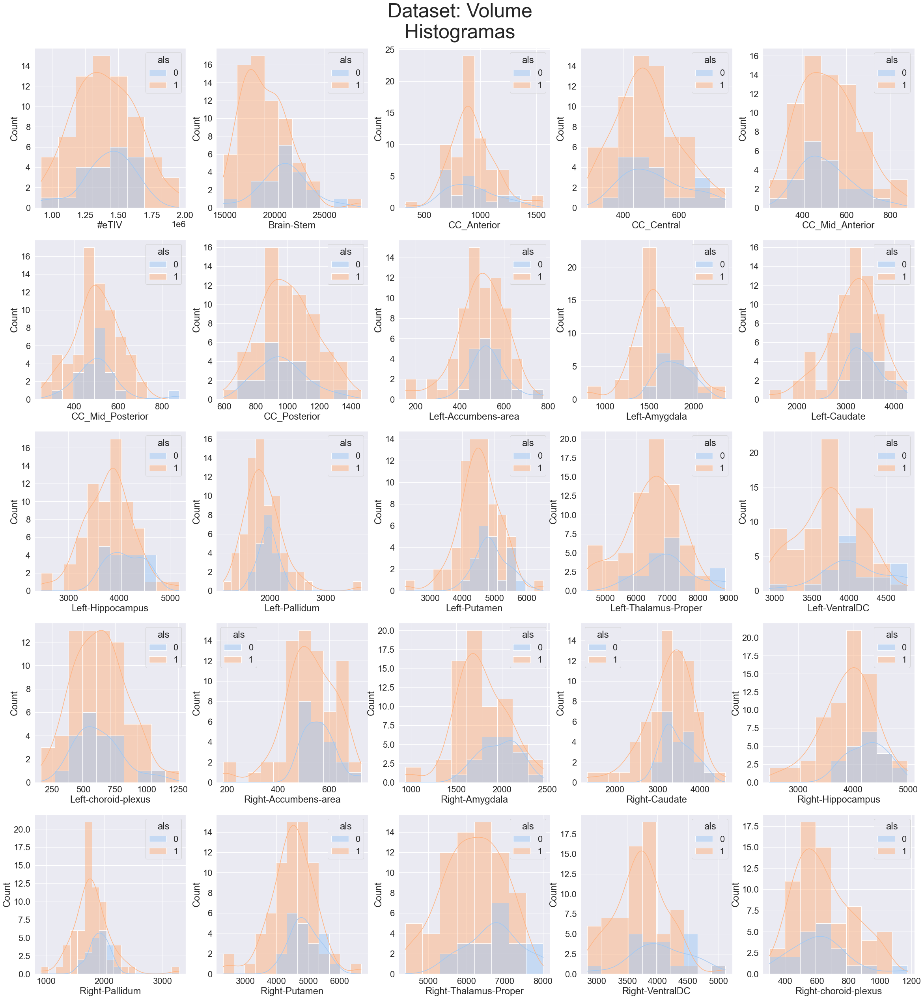

In [79]:
plotHist(volData, 'Volume', 0.94)

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


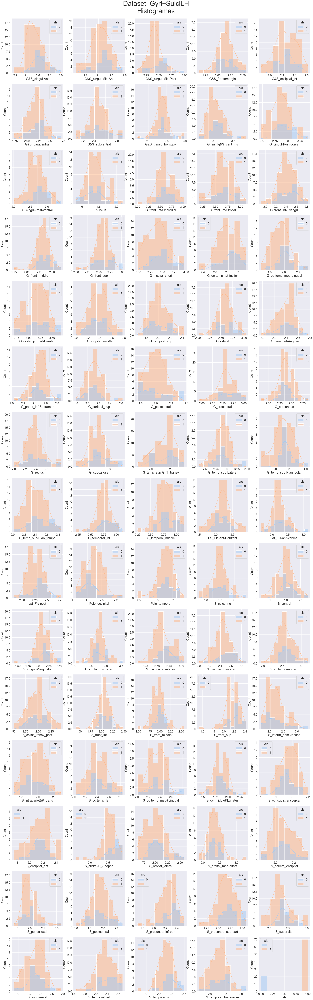

In [86]:
plotHist(gslhData, 'Gyri+SulciLH', 0.965)

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


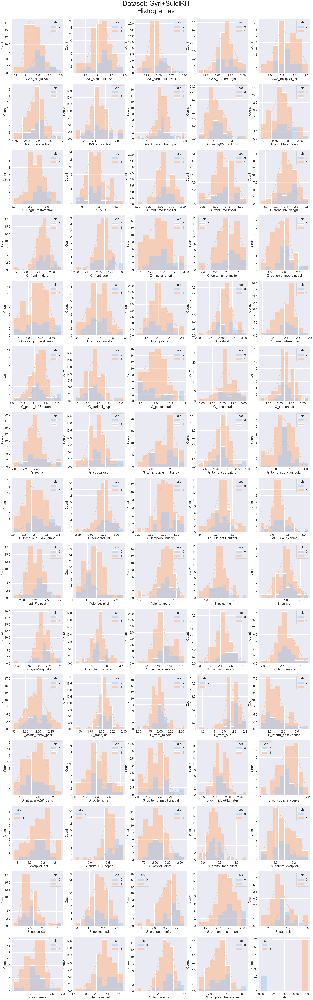

In [85]:
plotHist(gslhData, 'Gyri+SulciRH', 0.965)

### Dataset: Difusão

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


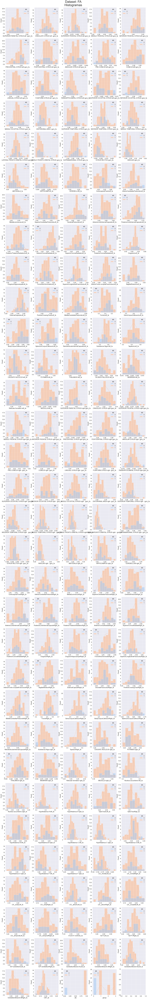

In [91]:
plotHist(faData, 'FA', 0.974)

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


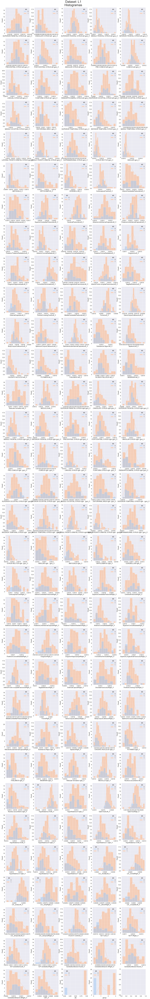

In [92]:
plotHist(l1Data, 'L1', 0.974)

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


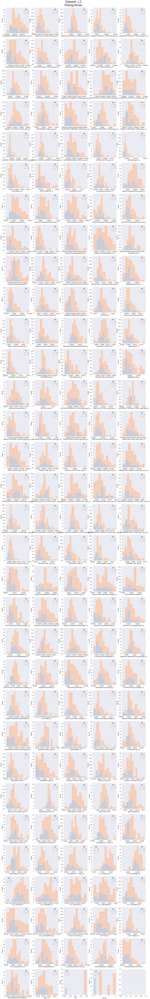

In [93]:
plotHist(l2Data, 'L2', 0.974)

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


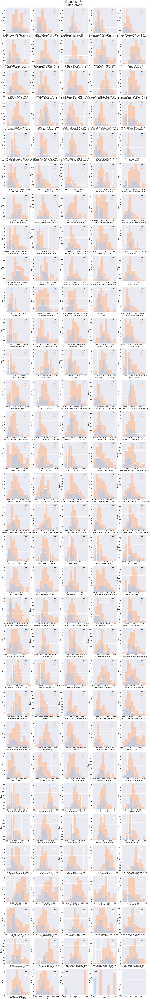

In [94]:
plotHist(l3Data, 'L3', 0.974)

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


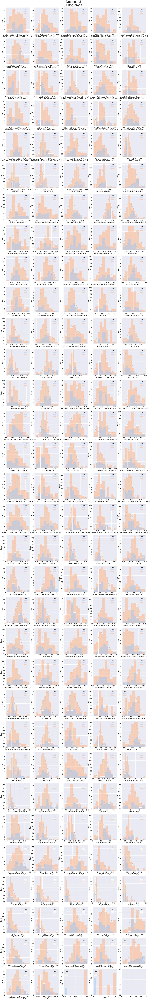

In [95]:
plotHist(vlData, 'vl', 0.974)

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


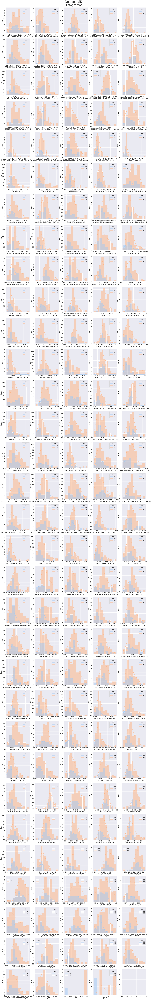

In [96]:
plotHist(newMetricsMD, 'MD', 0.974)

D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)
D:\Programs\Anaconda\lib\site-packages\seaborn\distributions.py:306: UserWarning: Dataset has 0 variance; skipping density estimate.
  warnings.warn(msg, UserWarning)


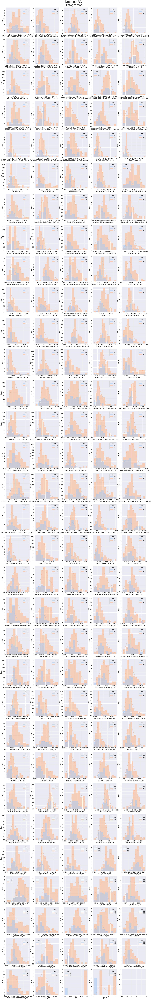

In [97]:
plotHist(newMetricsMD, 'RD', 0.974)

Observando os diversos histogramas, é possível notar que existem possíveis diferenças entre as duas populações em algumas variáveis, porém é necessário quantizar essas diferenças.

## Teste T de Student

O Teste T de Student pode ser utilizado para verificar se há diferença entre as médias de duas populações, cujas hipóteses são:

* H0: Não há diferença significativa entre as médias das populações de pacientes com ELA e controle
* H1: Há diferença significativa entre as médias das populações de pacientes com ELA e controle

Para todos os testes cujo $pvalue < alpha$, rejeita-se a hipótese nula (H0) em favor da hipótese alternativa (H1). O valor de alpha que será utilizada é $0.05$.

In [125]:
def tTest(dataset, target, label1, label2):
    data1 = dataset[dataset[target] == label1]
    data2 = dataset[dataset[target] == label2]

    alpha = 0.05;

    ### Reset vectors
    resultsFeature = []
    resultsPvalue = []
    resultsTstat = []
    n = 0
    
    ### Print results. Formatted for markdown
    ### Save only the features with pvalues < alpha
    for i in range(1, dataset.shape[1]):
        tstat, pvalue = stats.ttest_ind(data1.iloc[:,i], data2.iloc[:,i])
        if(pvalue < alpha):
            n = n + 1
            resultsFeature.append(data1.columns[i]);
            resultsPvalue.append(pvalue);
            resultsTstat.append(tstat)
            print("| %s | %f | %f |" %(data1.columns[i], pvalue, tstat))
        
### Create DataFrame
    resultsTest = pd.DataFrame(data={"feature":resultsFeature, "pvalue":resultsPvalue, "tstat":resultsTstat})
    return n, resultsTest

In [130]:
print('Comparação: Saudável vs ELA ')
print("| feature | pvalue | tstat |")
print("| --- | --- | --- |")
dtiAlsTestN, dtiAlsTestFeatures = tTest(dtiData, 'als', 0, 1)
t1AlsTestN, t1AlsTestFeatures = tTest(t1Data, 'als', 0, 1)

Comparação: Saudável vs ELA 
| feature | pvalue | tstat |
| --- | --- | --- |
| PARAHIPPOCAMPAL GYRUS left (gm)_fa | 0.039783 | -2.088087 |
| ENTORHINAL AREA  (gm)_fa | 0.018534 | -2.400955 |
| CorticospinalTractLeft_fa | 0.003854 | 2.971401 |
| InferiorCerebellarPeduncleLeft_fa | 0.003092 | 3.045608 |
| CerebralPeduncleLeft_fa | 0.001046 | 3.394779 |
| PosteriorLimbInternalCapsuleLeft_fa | 0.006649 | 2.782281 |
| FornixLeft_fa | 0.032032 | 2.179876 |
| GenuCorpusCallosumLeft_fa | 0.049612 | 1.991726 |
| SpleniumCorpusCallosumLeft_fa | 0.030992 | 2.193633 |
| PUTAMEN left_fa | 0.008723 | -2.684832 |
| GLOBUS PALLIDUS left_fa | 0.028112 | -2.233936 |
| MEDULLA left_fa | 0.005214 | 2.867625 |
| INFERIOR FRONTAL GYRUS right (gm)_fa | 0.040198 | 2.083621 |
| CerebralPeduncleRight_fa | 0.006609 | 2.784391 |
| AnteriorLimbInternalCapsuleRight_fa | 0.005225 | 2.866850 |
| PosteriorLimbInternalCapsuleRight_fa | 0.012378 | 2.555667 |
| FornixRight_fa | 0.014495 | 2.495921 |
| GenuCorpusCallosum

| PARAHIPPOCAMPAL GYRUS left (gm)_vl | 0.036825 | -2.121109 |
| SUPERIOR OCCIPITAL GYRUS left (gm)_vl | 0.037369 | -2.114872 |
| InferiorCerebellarPeduncleLeft_vl | 0.000651 | 3.540422 |
| MedialLemniscusLeft_vl | 0.016981 | 2.435039 |
| CerebralPeduncleLeft_vl | 0.001290 | 3.329088 |
| FornixStriaTerminalisLeft_vl | 0.045211 | 2.032632 |
| PUTAMEN left_vl | 0.013579 | 2.520731 |
| MIDDLE FRONTO-ORBITAL GYRUS right   (gm)_vl | 0.036415 | 2.125871 |
| GYRUS RECTUS right  (gm)_vl | 0.032861 | 2.169188 |
| InferiorCerebellarPeduncleRight_vl | 0.009690 | 2.646480 |
| MedialLemniscusRight_vl | 0.003726 | 2.982840 |
| TapatumRight_vl | 0.015914 | -2.460120 |
| PUTAMEN right_vl | 0.011695 | 2.576912 |
| THALAMUS right_vl | 0.044066 | 2.043833 |
| MEDULLA right_vl | 0.000674 | 3.529651 |
| Hypothalamus A left_vl | 0.022968 | 2.315965 |
| Hypothalamus C right_vl | 0.041239 | 2.072604 |
| Hypothalamus D right_vl | 0.029349 | 2.216200 |
| LVL_bodyRight_vl | 0.019194 | -2.387234 |
| ICP-cerebellum

In [131]:
print('Comparação: ELAs vs c9orf72')
print("| feature | pvalue | tstat |")
print("| --- | --- | --- |")
dtiGroupSCTestN, dtiGroupSCTestFeatures = tTest(dtiData, 'group', 1, 2)
t1GroupSCTestN, t1AlsGroupSCFeatures = tTest(t1Data, 'group', 1, 2)

Comparação: ELAs vs c9orf72
| feature | pvalue | tstat |
| --- | --- | --- |
| SUPERIOR PARIETAL GYRUS left  (gm)_fa | 0.022311 | 2.379757 |
| SUPERIOR FRONTAL GYRUS left (gm)_fa | 0.000302 | 3.967065 |
| MIDDLE FRONTAL GYRUS left (gm)_fa | 0.000909 | 3.591322 |
| INFERIOR FRONTAL GYRUS left (gm)_fa | 0.000218 | 4.076738 |
| PRECENTRAL GYRUS left (gm)_fa | 0.001426 | 3.433478 |
| ANGULAR GYRUS left (gm)_fa | 0.030852 | 2.240156 |
| PRE-CUNEUS left (gm)_fa | 0.041216 | 2.111204 |
| FUSIFORM GYRUS left  (gm)_fa | 0.000142 | 4.217713 |
| SUPERIOR TEMPORAL GYRUS (gm)_fa | 0.002120 | 3.291744 |
| INFERIOR TEMPORAL GYRUS (gm)_fa | 0.005665 | 2.928301 |
| MIDDLE TEMPORAL GYRUS (gm)_fa | 0.049183 | 2.030327 |
| LATERAL FRONTO-ORBITAL GYRUS (gm)_fa | 0.032935 | 2.211431 |
| SUPRAMARGINAL GYRUS (gm)_fa | 0.000782 | 3.643732 |
| PosteriorLimbInternalCapsuleLeft_fa | 0.006273 | 2.889404 |
| PosteriorThalamicRadiationLeft_fa | 0.018649 | 2.455069 |
| AnteriorCoronaRadiataLeft_fa | 0.000590 | 3.7404

| SUPERIOR PARIETAL GYRUS left  (gm)_rd | 0.003145 | -3.148231 |
| CINGULATE GYRUS left  (gm)_rd | 0.000437 | -3.842613 |
| SUPERIOR FRONTAL GYRUS left (gm)_rd | 0.000697 | -3.683395 |
| MIDDLE FRONTAL GYRUS left (gm)_rd | 0.000082 | -4.396199 |
| INFERIOR FRONTAL GYRUS left (gm)_rd | 0.000161 | -4.176579 |
| PRECENTRAL GYRUS left (gm)_rd | 0.004456 | -3.018976 |
| POSTCENTRAL GYRUS left (gm)_rd | 0.024617 | -2.337870 |
| ANGULAR GYRUS left (gm)_rd | 0.000181 | -4.136899 |
| PRE-CUNEUS left (gm)_rd | 0.000850 | -3.614756 |
| CUNEUS left (gm)_rd | 0.004541 | -3.011859 |
| FUSIFORM GYRUS left  (gm)_rd | 0.001629 | -3.386198 |
| PARAHIPPOCAMPAL GYRUS left (gm)_rd | 0.041362 | -2.109608 |
| SUPERIOR OCCIPITAL GYRUS left (gm)_rd | 0.005646 | -2.929558 |
| MIDDLE OCCIPITAL GYRUS (gm)_rd | 0.001510 | -3.413165 |
| ENTORHINAL AREA  (gm)_rd | 0.042084 | -2.101759 |
| SUPERIOR TEMPORAL GYRUS (gm)_rd | 0.006533 | -2.873820 |
| INFERIOR TEMPORAL GYRUS (gm)_rd | 0.002284 | -3.264976 |
| MIDDLE TEMP

| S_orbital-H_Shaped_y | 0.026715 | 2.296308 |
| S_precentral-inf-part_y | 0.049412 | 2.023530 |
| S_subparietal_y | 0.039134 | 2.129320 |
| S_temporal_sup_y | 0.027188 | 2.288777 |
Nt1 =  47
Ndti =  304
Nall =  351


In [132]:
print('Comparação: ELAs vs VAPB')
print("| feature | pvalue | tstat |")
print("| --- | --- | --- |")
dtiGroupSVTestN, dtiGroupSVTestFeatures = tTest(dtiData, 'group', 1, 3)
t1GroupSVTestN, t1AlsGroupSVFeatures = tTest(t1Data, 'group', 1, 3)

Comparação: ELAs vs VAPB
| feature | pvalue | tstat |
| --- | --- | --- |
| SUPERIOR PARIETAL GYRUS left  (gm)_fa | 0.041250 | -2.091941 |
| CINGULATE GYRUS left  (gm)_fa | 0.040664 | -2.098268 |
| SUPERIOR FRONTAL GYRUS left (gm)_fa | 0.040913 | -2.095573 |
| MIDDLE FRONTAL GYRUS left (gm)_fa | 0.004473 | -2.969440 |
| PRECENTRAL GYRUS left (gm)_fa | 0.000354 | -3.818348 |
| POSTCENTRAL GYRUS left (gm)_fa | 0.001710 | -3.304490 |
| ANGULAR GYRUS left (gm)_fa | 0.002125 | -3.230549 |
| PRE-CUNEUS left (gm)_fa | 0.024795 | -2.310301 |
| CUNEUS left (gm)_fa | 0.019098 | -2.417525 |
| SUPERIOR OCCIPITAL GYRUS left (gm)_fa | 0.010164 | -2.665605 |
| GYRUS RECTUS (gm)_fa | 0.030305 | -2.225781 |
| AMYGDALA_fa | 0.039315 | -2.113138 |
| HIPPOCAMPUS_fa | 0.005983 | -2.863933 |
| CEREBELLUM_fa | 0.027778 | -2.262685 |
| CorticospinalTractLeft_fa | 0.019181 | -2.415774 |
| MedialLemniscusLeft_fa | 0.000028 | -4.581550 |
| SuperiorCerebellarPeduncleLeft_fa | 0.026311 | -2.285509 |
| CerebralPedu

| BodyCorpusCallosumRight_vl | 0.048201 | -2.022337 |
| THALAMUS right_vl | 0.029196 | -2.241632 |
| MEDULLA right_vl | 0.002620 | 3.158238 |
| Hypothalamus B left_vl | 0.007383 | 2.786239 |
| Left-Thalamus-Proper | 0.039936 | -2.105254 |
| Left-choroid-plexus | 0.034395 | 2.170370 |
| group | 0.000000 | -inf |
| S_central_x | 0.009555 | -2.687315 |
| S_oc-temp_med&Lingual_x | 0.048750 | -2.016338 |
| S_oc_middle&Lunatus_x | 0.047835 | -2.024894 |
| S_oc_sup&transversal_x | 0.048379 | -2.019790 |
| G_postcentral_y | 0.034024 | -2.175052 |
| G_precentral_y | 0.036080 | -2.149658 |
| G_temp_sup-Plan_polar_y | 0.043943 | -2.062917 |
| S_circular_insula_inf_y | 0.037719 | -2.130295 |
Nt1 =  11
Ndti =  185
Nall =  196


In [133]:
print('Comparação: c9orf72 vs VAPB')
print("| feature | pvalue | tstat |")
print("| --- | --- | --- |")
dtiGroupCVTestN, dtiGroupCVTestFeatures = tTest(dtiData, 'group', 1, 2)
t1GroupCVTestN, t1AlsGroupCVFeatures = tTest(t1Data, 'group', 1, 2)

Comparação: c9orf72 vs VAPB
| feature | pvalue | tstat |
| --- | --- | --- |
| SUPERIOR PARIETAL GYRUS left  (gm)_fa | 0.022311 | 2.379757 |
| SUPERIOR FRONTAL GYRUS left (gm)_fa | 0.000302 | 3.967065 |
| MIDDLE FRONTAL GYRUS left (gm)_fa | 0.000909 | 3.591322 |
| INFERIOR FRONTAL GYRUS left (gm)_fa | 0.000218 | 4.076738 |
| PRECENTRAL GYRUS left (gm)_fa | 0.001426 | 3.433478 |
| ANGULAR GYRUS left (gm)_fa | 0.030852 | 2.240156 |
| PRE-CUNEUS left (gm)_fa | 0.041216 | 2.111204 |
| FUSIFORM GYRUS left  (gm)_fa | 0.000142 | 4.217713 |
| SUPERIOR TEMPORAL GYRUS (gm)_fa | 0.002120 | 3.291744 |
| INFERIOR TEMPORAL GYRUS (gm)_fa | 0.005665 | 2.928301 |
| MIDDLE TEMPORAL GYRUS (gm)_fa | 0.049183 | 2.030327 |
| LATERAL FRONTO-ORBITAL GYRUS (gm)_fa | 0.032935 | 2.211431 |
| SUPRAMARGINAL GYRUS (gm)_fa | 0.000782 | 3.643732 |
| PosteriorLimbInternalCapsuleLeft_fa | 0.006273 | 2.889404 |
| PosteriorThalamicRadiationLeft_fa | 0.018649 | 2.455069 |
| AnteriorCoronaRadiataLeft_fa | 0.000590 | 3.7404

| SLFF-tRight_md | 0.008134 | -2.789027 |
| SUPERIOR PARIETAL GYRUS left  (gm)_rd | 0.003145 | -3.148231 |
| CINGULATE GYRUS left  (gm)_rd | 0.000437 | -3.842613 |
| SUPERIOR FRONTAL GYRUS left (gm)_rd | 0.000697 | -3.683395 |
| MIDDLE FRONTAL GYRUS left (gm)_rd | 0.000082 | -4.396199 |
| INFERIOR FRONTAL GYRUS left (gm)_rd | 0.000161 | -4.176579 |
| PRECENTRAL GYRUS left (gm)_rd | 0.004456 | -3.018976 |
| POSTCENTRAL GYRUS left (gm)_rd | 0.024617 | -2.337870 |
| ANGULAR GYRUS left (gm)_rd | 0.000181 | -4.136899 |
| PRE-CUNEUS left (gm)_rd | 0.000850 | -3.614756 |
| CUNEUS left (gm)_rd | 0.004541 | -3.011859 |
| FUSIFORM GYRUS left  (gm)_rd | 0.001629 | -3.386198 |
| PARAHIPPOCAMPAL GYRUS left (gm)_rd | 0.041362 | -2.109608 |
| SUPERIOR OCCIPITAL GYRUS left (gm)_rd | 0.005646 | -2.929558 |
| MIDDLE OCCIPITAL GYRUS (gm)_rd | 0.001510 | -3.413165 |
| ENTORHINAL AREA  (gm)_rd | 0.042084 | -2.101759 |
| SUPERIOR TEMPORAL GYRUS (gm)_rd | 0.006533 | -2.873820 |
| INFERIOR TEMPORAL GYRUS (gm)

In [144]:
print('Comparação: Saudável vs ELA')
print('| Dataset | numberFeatures |')
print('| --- | --- |')
print('| %s | %d |' %('t1', t1AlsTestN))
print('| %s | %d |' %('dti', dtiAlsTestN))
print('| %s | %d |' %('all', (t1AlsTestN + dtiAlsTestN)))

print('\n')

print('Comparação: Subtipos de ELA')
print('| Dataset | Alvo1 | Alvo2 | numeroFeatures |')
print('| --- | --- | --- | --- |')
print('| %s | %s | %s | %d |' %('t1', 'ELAs', 'c90rf72', t1GroupSCTestN))
print('| %s | %s | %s | %d |' %('t1', 'ELAs', 'vapb', t1GroupSVTestN))
print('| %s | %s | %s | %d |' %('t1', 'c9orf72', 'vapb', t1GroupCVTestN))
print('| %s | %s | %s | %d |' %('dti', 'ELAs', 'c90rf72',dtiGroupSCTestN))
print('| %s | %s | %s | %d |' %('dti', 'ELAs', 'vapb',dtiGroupSVTestN))
print('| %s | %s | %s | %d |' %('dti', 'c9orf72', 'vapb',dtiGroupCVTestN))
print('| %s | %s | %s | %d |' %('all', 'ELAs', 'c90rf72', (t1GroupSCTestN + dtiGroupSCTestN)))
print('| %s | %s | %s | %d |' %('all', 'ELAs', 'vapb', (t1GroupSVTestN + dtiGroupSVTestN)))
print('| %s | %s | %s | %d |' %('all', 'c9orf72', 'vapb', (t1GroupCVTestN + dtiGroupCVTestN)))

Comparação: Saudável vs ELA
| Dataset | numberFeatures |
| --- | --- |
| t1 | 55 |
| dti | 228 |
| all | 283 |


Comparação: Subtipos de ELA
| Dataset | Alvo1 | Alvo2 | numeroFeatures |
| --- | --- | --- | --- |
| t1 | ELAs | c90rf72 | 47 |
| t1 | ELAs | vapb | 11 |
| t1 | c9orf72 | vapb | 47 |
| dti | ELAs | c90rf72 | 304 |
| dti | ELAs | vapb | 185 |
| dti | c9orf72 | vapb | 304 |
| all | ELAs | c90rf72 | 351 |
| all | ELAs | vapb | 196 |
| all | c9orf72 | vapb | 351 |


## Export data

In [145]:
dtiAlsTestFeatures.to_csv('../data/processed/dtiAlsTestFeatures.csv', index=False)
t1AlsTestFeatures.to_csv('../data/processed/t1AlsTestFeatures.csv', index=False)
dtiGroupSCTestFeatures.to_csv('../data/processed/dtiGroupSCTestFeatures.csv', index=False)
t1AlsGroupSCFeatures.to_csv('../data/processed/t1AlsGroupSCFeatures.csv', index=False)
dtiGroupSVTestFeatures.to_csv('../data/processed/dtiGroupSVTestFeatures.csv', index=False)
t1AlsGroupSVFeatures.to_csv('../data/processed/t1AlsGroupSVFeatures.csv', index=False)
dtiGroupCVTestFeatures.to_csv('../data/processed/dtiGroupCVTestFeatures.csv', index=False)
t1AlsGroupCVFeatures.to_csv('../data/processed/t1AlsGroupCVFeatures.csv', index=False)